In [1]:
import torch 
import torch.tensor as T
import numpy as np
import collections
import time
import pickle 
from tqdm import tqdm

import sys
import os

sys.path.append('../engine/')
sys.path.append('../funcs/')
sys.setrecursionlimit(10000)

from matplotlib import pyplot as plt
import seaborn as sns
sns.set_style("white")

from Model import *
from eval_funcs import *
from plot_funcs import *
from utils import *
from csv_utils import *
from psf_fit_funcs import *
from tifffile import *
from IPython.display import display, clear_output
import glob
import h5py

import matplotlib.animation as animation
from IPython.display import HTML

from numba import njit

In [2]:
HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [95]:
def max_proj_img(volume, sigma=0, contrast_fac=10, crange=0.5, coffset=0.1): 
           
    # adjust colormap
    volume = volume.transpose([0,2,1])
    
    max_count = np.max(volume, 0)
    max_ind = np.argmax(volume, 0)
    
    density = max_count
    zavg = max_ind/np.shape(volume)[0]
    
    hue = zavg[:,:,None] * crange + coffset
    sat = np.ones(density.shape)[:,:,None]
    val = (density/np.max(density))[:,:,None]
    sr_HSV = np.concatenate((hue,sat,val),2)
    sr_RGB = hsv_to_rgb(sr_HSV)
    # %have to gaussian blur in rgb domain
    if sigma:
        sr_RGB = cv2.GaussianBlur(sr_RGB,(11,11),sigma)
        sr_HSV = rgb_to_hsv(sr_RGB)

    val = sr_HSV[:,:,2]
#     val = imadjust(val, tol=0, vin=[0,1], vout=(0,10)) - 0.5

    sr_HSVfinal = np.concatenate((sr_HSV[:,:,:2],val[:,:,None]),2)
    sr_RGBfinal= hsv_to_rgb(sr_HSVfinal)
    
    sr_Im = PIL.Image.fromarray(np.array(np.round(sr_RGBfinal*256), dtype='uint8'))
    enhancer = ImageEnhance.Contrast(sr_Im)
    sr_Im = enhancer.enhance(contrast_fac)

    return sr_Im.transpose(PIL.Image.TRANSPOSE)

In [112]:
def make_gif(images, strings, filename):

    sl = np.index_exp[:,:]
    fig = plt.figure(figsize=(20,20))
    ax = fig.add_subplot(111)
    ims=[]
    
    for i in range(len(images)):

        bar, = plt.plot([800,900],[930,930], linewidth = 10, color='white')
        bar_ttl = plt.text(0.850, 0.10, '1000 nm', color='white',horizontalalignment='center', verticalalignment='bottom',transform=ax.transAxes, size=25)

        im =plt.imshow(np.array(images[i])[sl], animated=True)
        ttl = plt.text(0.1, 0.05, strings[i], color='white', horizontalalignment='left', verticalalignment='bottom', transform=ax.transAxes, size=50)
        ims.append([im, bar, ttl, bar_ttl])


    plt.tight_layout()
    plt.axis('off')

    ani = animation.ArtistAnimation(fig, ims, interval=800, blit=False,repeat_delay=1000)
    ani.save('/groups/turaga/home/speisera/share_TUM/' + filename + '.gif')
    
def make_html(images, strings, interval=1200, figsize=(12,12)):

    sl = np.index_exp[:,:]
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    ims=[]

    for i in range(len(images)):

        bar, = plt.plot([800,900],[930,930], linewidth = 10, color='white')
        bar_ttl = plt.text(0.850, 0.10, '1000 nm', color='white',horizontalalignment='center', verticalalignment='bottom',transform=ax.transAxes, size=15)

        im = plt.imshow(np.array(images[i])[sl], animated=True);
        ttl = plt.text(0.1, 0.05, strings[i], color='white', horizontalalignment='left', verticalalignment='bottom', transform=ax.transAxes, size=25)
        ims.append([im, bar, ttl, bar_ttl])

    plt.tight_layout()
    plt.axis('off')
    plt.close()

    ani = animation.ArtistAnimation(fig, ims, interval=interval, blit=False,repeat_delay=0)
    return HTML(ani.to_jshtml())    

In [5]:
with h5py.File('results/full_run_1/fig_b_vols.hdf5', 'r') as f:

    dec_p10_count = f['dec_p10_count'][()]
    wes_p10_count = f['wes_p10_count'][()]
    
    dec_p10_n1 = f['dec_p10_n1'][()]
    dec_p10_n2 = f['dec_p10_n2'][()]
    
#     wes_p10_c2 = f['wes_p10_c2'][()]
    wes_p10_c3 = f['wes_p10_c3'][()]    

In [34]:
dec_p10_n1_img = max_proj_img(np.clip(dec_p10_n1.transpose(2,0,1),0,2.0)[::-1],contrast_fac=2.4, crange=0.42, coffset=0)
dec_p10_n2_img = max_proj_img(np.clip(dec_p10_n2.transpose(2,0,1),0,2.0)[::-1],contrast_fac=2.4, crange=0.42, coffset=0)
wes_conv_img = max_proj_img(np.clip(wes_p10_c3.transpose(2,0,1),0,2.5)[::-1],contrast_fac=2.0, sigma=1., crange=0.42, coffset=0)
dec_p10_count_img = max_proj_img(np.clip(dec_p10_count.transpose(2,0,1),0,5.0)[::-1],contrast_fac=2.4, sigma=1.3, crange=0.42, coffset=0)
wes_p10_count_img = max_proj_img(np.clip(wes_p10_count.transpose(2,0,1),0,5.0)[::-1],contrast_fac=2.4, sigma=1.3, crange=0.42, coffset=0)
# dec_p10_n1_img

In [28]:
# %matplotlib inline
# make_gif([dec_p10_n1_img,wes_conv_img], ['DECODE Conv.', 'Legant Conv.'], 'decode_wes_conv')

The issue with my previous plots was that I was using the mean over the Z-axis when calculating intensities, which is problematic for large volumes and leads to blurry images.   
These are all max projections which are much crisper. However, they require to actually make a volume histogram as a first step.  
There is two ways to do this, the quick one is just bin counting, the second one convolving the emitter position with the Gaussian using the inferred sigmas.  
There is a paper that shows that this is the best rendering method.

I think it would be cool for our paper if we can show two things:  
First our locations are more precise, and second our method is the only one that produces accurate sigma predictions for difficult conditions, thus allowing for better rendering. 

All images below are made using the same number of predictions. For that I used 40% of the decode predictions. On the very bottom there is a comparison using 40% and 80%.  
Contrast is adjusted by hand using PIL.ImageEnhance.Contrast, is there a way to automate this?

This is the image from their paper that we are comparing to.

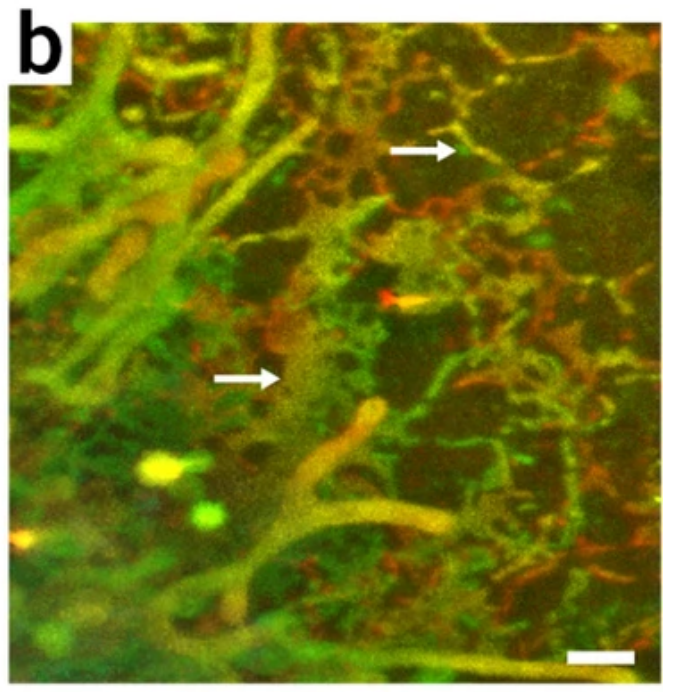

# Comparison count volumes

Pixel size is 10nm, after the max projection the image is blurred with a 13nm Gaussian. This should be closest to their method.  
Hower my image of Wes' data still looks worse then the paper image. We will have to ask him about the exact steps he used. 

In [113]:
make_html([dec_p10_count_img,wes_p10_count_img],['DECODE Count.', 'Legant Count.'])

# Comparison convolution volumes

Pixel size is 10nm. Both my DECODE and Wes' method produce uncertainty estimates in x,y,z which are uncorrelated in the camera view.
These images are from the rotated 'top' perspective though (around the y-axis). So I rotated the variances and then convolved using the resulting covariance matrix.
These are histograms for the sigmas pre- and post rotation. As you can see Wes' sigmas are very close to zero most of the times.  
This makes convolving almost useless because for small sigmas it is basically the same as counting. So to get a reasonable image I again had to blur his image, while with DECODE you get a nice smooth image right away. 
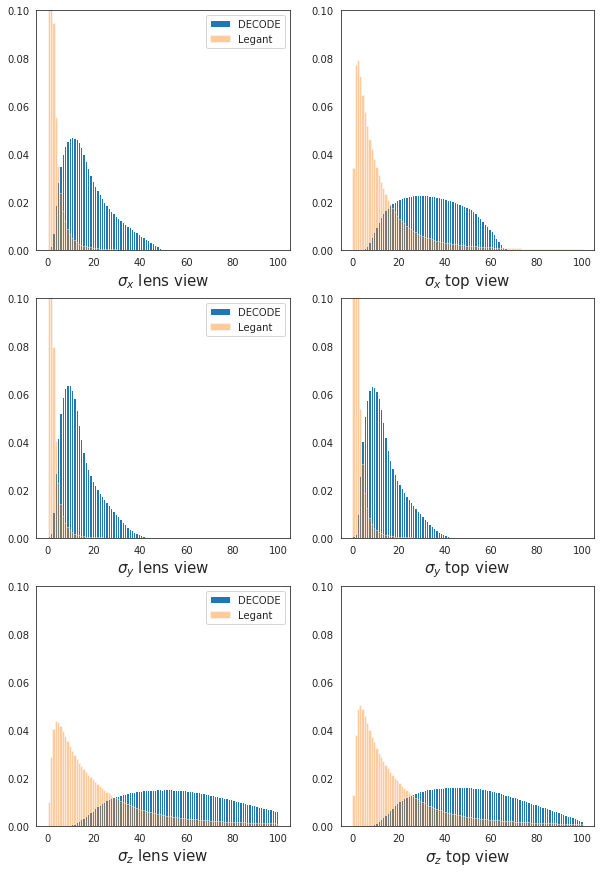

In [114]:
make_html([dec_p10_n1_img,wes_conv_img],['DECODE Conv.', 'Legant Conv.'])

# Full 'count volumes'

The convolution method is rather expensive though. So for now I just used counting with 20nm pixels (no blurring). Also it is a huge pain working with volumes of that size cause you run out of memory at every step.

In [109]:
with h5py.File('results/full_run_1/fig_a_vols.hdf5', 'r') as f:

    dec_full = f['dec_p20_count'][()]
    wes_full = f['wes_p20_count'][()]

In [119]:
dec_full_img = max_proj_img(np.clip(dec_full[:,:,100:400].transpose(2,1,0),0,20),contrast_fac=2., crange=1., coffset=0)

In [120]:
# max_proj_img(np.clip(dec_full[:,:,290:590].transpose(2,1,0),0,20),contrast_fac=1., crange=1., coffset=0)
wes_full_img = max_proj_img(np.clip(wes_full[:,:,100:400].transpose(2,1,0),0,20),contrast_fac=2.5, crange=1., coffset=0)

In [133]:
def make_html(images, strings, interval=1200, figsize=(12,12), pix_size=10):

    sl = np.index_exp[:,:]
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    ims=[]
    
    h, w = np.array(images[0])[sl].shape[:2]

    for i in range(len(images)):

        bar, = plt.plot([0.8*w,0.8*w+1000/pix_size],[0.93*h,0.93*h], linewidth = 10, color='white')
        bar_ttl = plt.text(0.80, 0.10, '1000 nm', color='white',horizontalalignment='left', verticalalignment='bottom',transform=ax.transAxes, size=15*pix_size/10)

        im = plt.imshow(np.array(images[i])[sl], animated=True);
        ttl = plt.text(0.1, 0.05, strings[i], color='white', horizontalalignment='left', verticalalignment='bottom', transform=ax.transAxes, size=25*pix_size/10)
        ims.append([im, bar, ttl, bar_ttl])

    plt.tight_layout()
    plt.axis('off')
    plt.close()

    ani = animation.ArtistAnimation(fig, ims, interval=interval, blit=False,repeat_delay=0)
    return HTML(ani.to_jshtml())    

In [134]:
make_html([dec_full_img,wes_full_img],['DECODE', 'Legant'], interval=1200, figsize=(35,30), pix_size=20)

# DECODE using twice as many points

I know it looks like it's a bug because there is basically no difference. I guess it's because of how the max projection works, and because all added localizations have lower precision?

In [135]:
make_html([dec_p10_n1_img,dec_p10_n2_img],['DECODE 40%', 'DECODE 80%'])

In [137]:
5

5